In [2]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("mateuszbuda/lgg-mri-segmentation")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/lgg-mri-segmentation


In [15]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
from glob import glob

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.nn.functional as F


In [16]:
# Base dataset path
base_dir = "/kaggle/input/lgg-mri-segmentation"

# Recursively get all folders inside the dataset
all_dirs = glob(os.path.join(base_dir, "**"), recursive=True)
patient_dirs = [d for d in all_dirs if os.path.isdir(d)]

print(f"Total candidate folders: {len(patient_dirs)}")


Total candidate folders: 224


In [17]:
class MRIDataset(Dataset):
    def __init__(self, image_dirs):
        self.image_mask_pairs = []

        for dir_path in image_dirs:
            img_path = os.path.join(dir_path, "FLAIR.nii.gz")
            mask_path = os.path.join(dir_path, "seg.nii.gz")

            if not os.path.exists(img_path) or not os.path.exists(mask_path):
                continue  # Skip folders missing files

            print(f"✅ Using: {dir_path}")

            img = nib.load(img_path).get_fdata()
            mask = nib.load(mask_path).get_fdata()

            for i in range(img.shape[2]):
                img_slice = img[:, :, i]
                mask_slice = mask[:, :, i]

                if np.max(mask_slice) > 0:
                    self.image_mask_pairs.append((img_slice, mask_slice))

        print(f"Total slices loaded: {len(self.image_mask_pairs)}")

    def __len__(self):
        return len(self.image_mask_pairs)

    def __getitem__(self, idx):
        img, mask = self.image_mask_pairs[idx]

        img = np.expand_dims(img, axis=0)
        mask = np.expand_dims(mask, axis=0)

        img = torch.tensor(img, dtype=torch.float32)
        mask = torch.tensor(mask, dtype=torch.float32)

        img = (img - img.min()) / (img.max() - img.min() + 1e-5)
        mask = (mask > 0).float()

        return img, mask


In [18]:
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        self.enc1 = self.conv_block(1, 64)
        self.pool1 = nn.MaxPool2d(2)
        self.enc2 = self.conv_block(64, 128)

        self.up1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.dec1 = self.conv_block(128, 64)

        self.out_conv = nn.Conv2d(64, 1, 1)

    def conv_block(self, in_ch, out_ch):
        return nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        enc1 = self.enc1(x)
        enc2 = self.enc2(self.pool1(enc1))

        up1 = self.up1(enc2)
        merge = torch.cat([up1, enc1], dim=1)
        dec1 = self.dec1(merge)

        return torch.sigmoid(self.out_conv(dec1))


Total masks found: 3929
Total images found: 3929


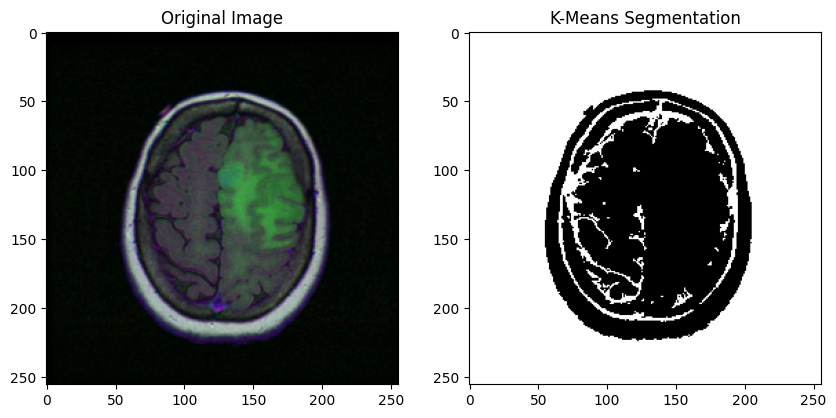

In [21]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from glob import glob

def load_image(img_path):
    """
    Load image and convert to RGB format
    """
    img = cv2.imread(img_path)
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB

def kmeans_segment(img, k=3):
    """
    Apply KMeans segmentation to isolate tumor regions.
    """
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
    Z = gray.reshape((-1, 1))  # Reshape to 1D array of pixels
    Z = np.float32(Z)

    # Define criteria and apply kmeans
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    _, labels, centers = cv2.kmeans(Z, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    centers = np.uint8(centers)
    segmented = centers[labels.flatten()]  # Reconstruct segmented image
    segmented_img = segmented.reshape(gray.shape)

    # Get the darkest cluster assuming the tumor is darker
    tumor_mask = (segmented_img == np.min(centers)).astype(np.uint8) * 255  # Create mask
    return tumor_mask

def show_results(img, mask, title="K-Means Segmentation"):
    """
    Display original image and its mask side by side
    """
    plt.figure(figsize=(10, 7))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title("Original Image")
    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.title(title)
    plt.show()

# Dataset path
data_dir = "/kaggle/input/lgg-mri-segmentation/kaggle_3m"

# Collect paths to images and masks
masks_paths = glob(f'{data_dir}/*/*_mask*')  # Collect mask file paths
images_paths = [mask.replace('_mask', '') for mask in masks_paths]  # Corresponding image paths

# Ensure we have images and masks
print(f"Total masks found: {len(masks_paths)}")
print(f"Total images found: {len(images_paths)}")

# Example: Process the 5th image and its corresponding mask
img_path = images_paths[4]
mask_path = masks_paths[4]

# Load image
img = load_image(img_path)

# Segment using K-means
mask = kmeans_segment(img, k=3)

# Display results
show_results(img, mask)


In [33]:
import torch
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim

In [40]:
import cv2
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from glob import glob
import matplotlib.pyplot as plt

# UNet model (simplified)
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super(UNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.middle = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.decoder = nn.Sequential(
            nn.Conv2d(128, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, out_channels, kernel_size=3, padding=1),
            nn.Sigmoid()  # Use sigmoid activation for binary segmentation
        )
    
    def forward(self, x):
        x1 = self.encoder(x)
        x2 = self.middle(x1)
        x3 = self.decoder(x2)
        return x3

class MRIDataset(Dataset):
    def __init__(self, img_paths, mask_paths, transform=None, target_size=(128, 128)):
        self.img_paths = img_paths
        self.mask_paths = mask_paths
        self.transform = transform
        self.target_size = target_size

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img = cv2.imread(self.img_paths[idx])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, self.target_size)

        mask = cv2.imread(self.mask_paths[idx], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, self.target_size)

        if self.transform:
            img = self.transform(img)
            mask = self.transform(mask)

        # Normalize and ensure correct shape for both inputs and masks
        img = torch.tensor(img).float().permute(2, 0, 1) / 255.0
        
        # Convert mask to tensor and ensure correct shape
        mask = torch.tensor(mask).float()  # Convert mask to tensor
        if mask.ndimension() == 2:  # If it's 2D, add a channel dimension
            mask = mask.unsqueeze(0)

        mask = mask / 255.0  # Normalize mask

        return img, mask

def load_image(img_path):
    """
    Load image and convert to RGB format
    """
    img = cv2.imread(img_path)
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB

def kmeans_segment(img, k=3):
    """
    Apply KMeans segmentation to isolate tumor regions.
    """
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
    Z = gray.reshape((-1, 1))  # Reshape to 1D array of pixels
    Z = np.float32(Z)

    # Define criteria and apply kmeans
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    _, labels, centers = cv2.kmeans(Z, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    centers = np.uint8(centers)
    segmented = centers[labels.flatten()]  # Reconstruct segmented image
    segmented_img = segmented.reshape(gray.shape)

    # Get the darkest cluster assuming the tumor is darker
    tumor_mask = (segmented_img == np.min(centers)).astype(np.uint8) * 255  # Create mask
    return tumor_mask

def show_results(img, mask, title="K-Means Segmentation"):
    """
    Display original image and its mask side by side
    """
    plt.figure(figsize=(10, 7))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title("Original Image")
    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.title(title)
    plt.show()


# Dataset path
data_dir = "/kaggle/input/lgg-mri-segmentation/kaggle_3m"

# Collect paths to images and masks
masks_paths = glob(f'{data_dir}/*/*_mask*')  # Collect mask file paths
images_paths = [mask.replace('_mask', '') for mask in masks_paths]  # Corresponding image paths

# Ensure we have images and masks
print(f"Total masks found: {len(masks_paths)}")
print(f"Total images found: {len(images_paths)}")

# Prepare Dataset and Dataloader
dataset = MRIDataset(images_paths, masks_paths)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True)

# Setup Model, Loss Function, Optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCELoss()  # Binary cross-entropy loss
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# Training loop
for epoch in range(5):  # Increase epochs as needed
    model.train()
    total_loss = 0

    for imgs, masks in dataloader:
        imgs, masks = imgs.to(device), masks.to(device)

        # Forward pass
        preds = model(imgs)

        # Ensure the prediction has the correct number of dimensions (N, 1, H, W)
        preds = preds.unsqueeze(1) if preds.ndimension() == 3 else preds  # Add a channel dimension if necessary

        # Resize the prediction to match the mask size (128, 128)
        preds_resized = F.interpolate(preds, size=(128, 128), mode='bilinear', align_corners=False)

        # Now ensure that both the prediction and mask have the same shape for the loss function
        preds_resized = preds_resized.squeeze(1)  # Remove the channel dimension after resizing
        masks = masks.squeeze(1)  # Ensure mask is also squeezed to [batch_size, height, width]

        # Compute the loss
        loss = criterion(preds_resized, masks)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    print(f"Epoch {epoch+1}, Loss: {total_loss:.4f}")


Total masks found: 3929
Total images found: 3929
Epoch 1, Loss: 49.2349
Epoch 2, Loss: 26.2705
Epoch 3, Loss: 23.0476
Epoch 4, Loss: 21.2549
Epoch 5, Loss: 20.1520


Total masks found: 3929
Total images found: 3929
Epoch 1, Loss: 50.8988
Epoch 2, Loss: 25.6499
Epoch 3, Loss: 22.3023
Epoch 4, Loss: 20.3886
Epoch 5, Loss: 19.1459


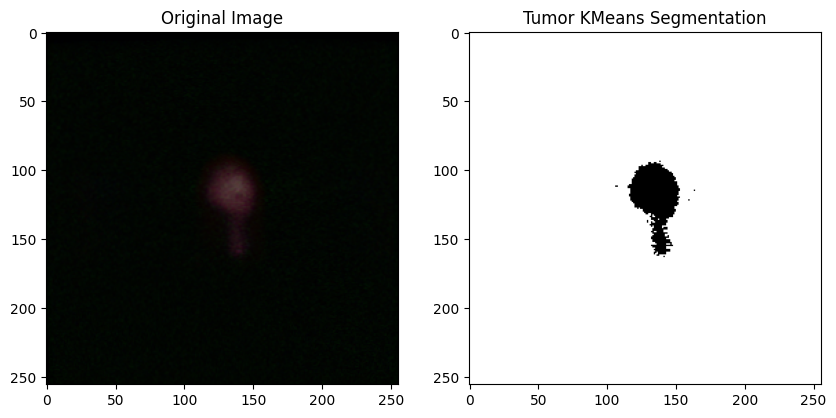

In [43]:
import cv2
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from glob import glob
import matplotlib.pyplot as plt

# UNet model (simplified)
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super(UNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.middle = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.decoder = nn.Sequential(
            nn.Conv2d(128, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, out_channels, kernel_size=3, padding=1),
            nn.Sigmoid()  # Use sigmoid activation for binary segmentation
        )
    
    def forward(self, x):
        x1 = self.encoder(x)
        x2 = self.middle(x1)
        x3 = self.decoder(x2)
        return x3

class MRIDataset(Dataset):
    def __init__(self, img_paths, mask_paths, transform=None, target_size=(128, 128)):
        self.img_paths = img_paths
        self.mask_paths = mask_paths
        self.transform = transform
        self.target_size = target_size

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img = cv2.imread(self.img_paths[idx])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, self.target_size)

        mask = cv2.imread(self.mask_paths[idx], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, self.target_size)

        if self.transform:
            img = self.transform(img)
            mask = self.transform(mask)

        # Normalize and ensure correct shape for both inputs and masks
        img = torch.tensor(img).float().permute(2, 0, 1) / 255.0
        
        # Convert mask to tensor and ensure correct shape
        mask = torch.tensor(mask).float()  # Convert mask to tensor
        if mask.ndimension() == 2:  # If it's 2D, add a channel dimension
            mask = mask.unsqueeze(0)

        mask = mask / 255.0  # Normalize mask

        return img, mask

def kmeans_segment(img, k=3):
    """
    Apply KMeans segmentation to isolate tumor regions.
    """
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
    Z = gray.reshape((-1, 1))  # Reshape to 1D array of pixels
    Z = np.float32(Z)

    # Define criteria and apply kmeans
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    _, labels, centers = cv2.kmeans(Z, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    centers = np.uint8(centers)
    segmented = centers[labels.flatten()]  # Reconstruct segmented image
    segmented_img = segmented.reshape(gray.shape)

    # Get the darkest cluster assuming the tumor is darker
    tumor_mask = (segmented_img == np.min(centers)).astype(np.uint8) * 255  # Create mask
    return tumor_mask

def show_results(img, mask, title="K-Means Segmentation"):
    """
    Display original image and its mask side by side
    """
    plt.figure(figsize=(10, 7))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title("Original Image")
    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.title(title)
    plt.show()


# Dataset path
data_dir = "/kaggle/input/lgg-mri-segmentation/kaggle_3m"

# Collect paths to images and masks
masks_paths = glob(f'{data_dir}/*/*_mask*')  # Collect mask file paths
images_paths = [mask.replace('_mask', '') for mask in masks_paths]  # Corresponding image paths

# Ensure we have images and masks
print(f"Total masks found: {len(masks_paths)}")
print(f"Total images found: {len(images_paths)}")

# Prepare Dataset and Dataloader
dataset = MRIDataset(images_paths, masks_paths)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True)

# Setup Model, Loss Function, Optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCELoss()  # Binary cross-entropy loss
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# Training loop
for epoch in range(5):  # Increase epochs as needed
    model.train()
    total_loss = 0

    for imgs, masks in dataloader:
        imgs, masks = imgs.to(device), masks.to(device)

        # Forward pass
        preds = model(imgs)

        # Ensure the prediction has the correct number of dimensions (N, 1, H, W)
        preds = preds.unsqueeze(1) if preds.ndimension() == 3 else preds  # Add a channel dimension if necessary

        # Resize the prediction to match the mask size (128, 128)
        preds_resized = F.interpolate(preds, size=(128, 128), mode='bilinear', align_corners=False)

        # Now ensure that both the prediction and mask have the same shape for the loss function
        preds_resized = preds_resized.squeeze(1)  # Remove the channel dimension after resizing
        masks = masks.squeeze(1)  # Ensure mask is also squeezed to [batch_size, height, width]

        # Compute the loss
        loss = criterion(preds_resized, masks)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    print(f"Epoch {epoch+1}, Loss: {total_loss:.4f}")

# You can now run the KMeans segmentation for a sample MRI image
sample_img_path = images_paths[0]
sample_img = cv2.imread(sample_img_path)
tumor_mask_kmeans = kmeans_segment(sample_img)

# Display results
show_results(sample_img, tumor_mask_kmeans, "Tumor KMeans Segmentation")


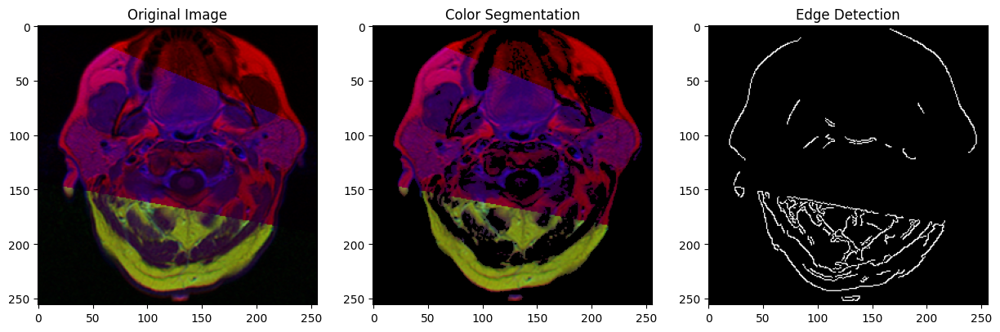

In [46]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def color_segmentation(img, lower_color=(0, 30, 60), upper_color=(180, 255, 255)):
    """
    Apply color segmentation to isolate regions based on color range (using HSV color space).
    """
    # Convert image to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Create mask using the given color range
    mask = cv2.inRange(hsv, lower_color, upper_color)

    # Bitwise-AND mask and original image to isolate the tumor region
    segmented_img = cv2.bitwise_and(img, img, mask=mask)

    return segmented_img, mask

def edge_detection(img, threshold1=100, threshold2=200):
    """
    Apply Canny edge detection to find edges around the tumor.
    """
    # Convert the image to grayscale for edge detection
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, threshold1, threshold2)

    return edges

def show_results(img, segmented_img, edges, title="Color Segmentation & Edge Detection"):
    """
    Display the original image, color segmented image, and edges side by side.
    """
    plt.figure(figsize=(15, 7))
    
    # Display the original image
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title("Original Image")
    
    # Display the color segmented image
    plt.subplot(1, 3, 2)
    plt.imshow(cv2.cvtColor(segmented_img, cv2.COLOR_BGR2RGB))
    plt.title("Color Segmentation")
    
    # Display the edges
    plt.subplot(1, 3, 3)
    plt.imshow(edges, cmap='gray')
    plt.title("Edge Detection")
    
    plt.show()

# Load a different sample image (change this to your new image path)
new_sample_img_path = '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_CS_4941_19960909/TCGA_CS_4941_19960909_1.tif'  # Change this to the new image path
sample_img = cv2.imread(new_sample_img_path)

# Ensure the image was loaded correctly
if sample_img is None:
    print("Error: Image not found!")
else:
    # Apply color segmentation (you can adjust the color range based on the tumor color in the images)
    segmented_img, color_mask = color_segmentation(sample_img)

    # Apply edge detection
    edges = edge_detection(sample_img)

    # Display the results
    show_results(sample_img, segmented_img, edges)


In [67]:
import torch
import torch.nn as nn

class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        def conv_block(in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
                nn.ReLU(inplace=True)
            )

        self.encoder1 = conv_block(1, 64)
        self.pool1 = nn.MaxPool2d(2)
        self.encoder2 = conv_block(64, 128)
        self.pool2 = nn.MaxPool2d(2)

        self.bottleneck = conv_block(128, 256)

        self.upconv2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.decoder2 = conv_block(256, 128)

        self.upconv1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.decoder1 = conv_block(128, 64)

        self.final_conv = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        enc1 = self.encoder1(x)               # (1 -> 64)
        enc2 = self.encoder2(self.pool1(enc1))# (64 -> 128)
        bottleneck = self.bottleneck(self.pool2(enc2)) # (128 -> 256)

        dec2 = self.upconv2(bottleneck)       # (256 -> 128)
        dec2 = self.decoder2(torch.cat([dec2, enc2], dim=1))  # skip connection

        dec1 = self.upconv1(dec2)             # (128 -> 64)
        dec1 = self.decoder1(torch.cat([dec1, enc1], dim=1))  # skip connection

        return torch.sigmoid(self.final_conv(dec1))  # Final mask prediction (1 channel)


In [68]:
import torch.nn as nn

criterion = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)


[1] Dice Score: 0.0000


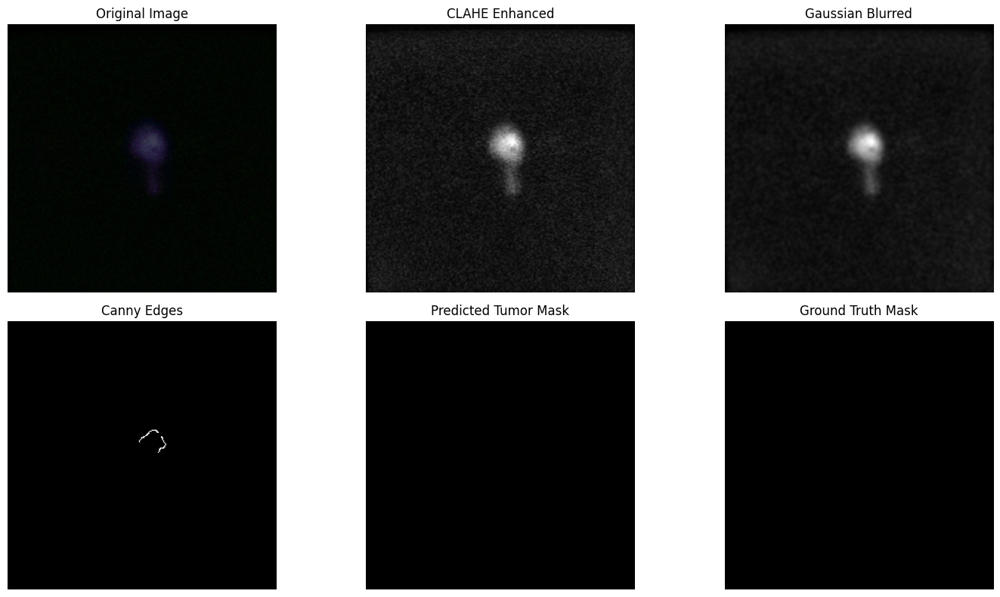

[2] Dice Score: 0.0000


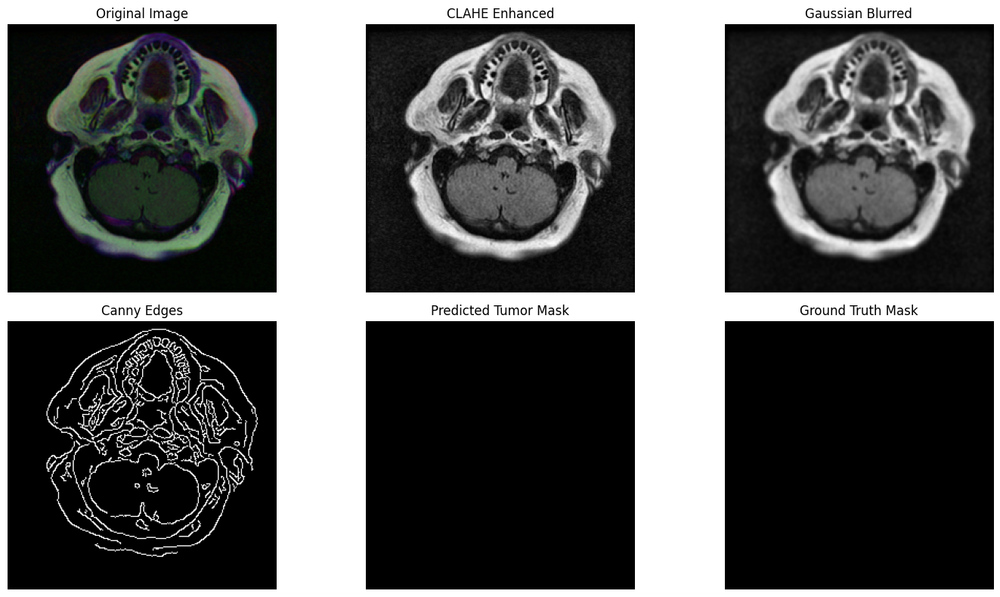

[3] Dice Score: 0.0000


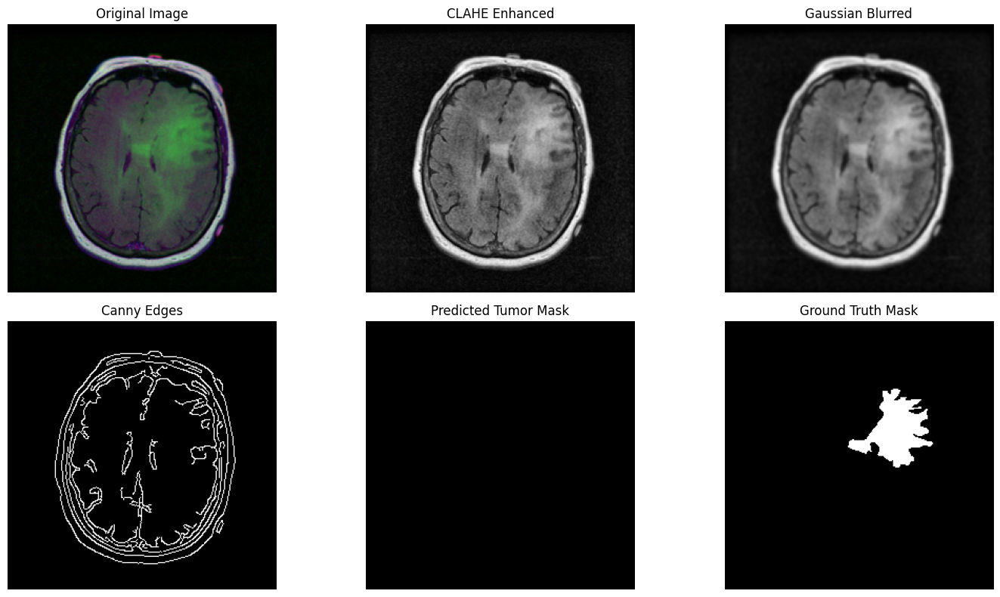

[4] Dice Score: 0.0000


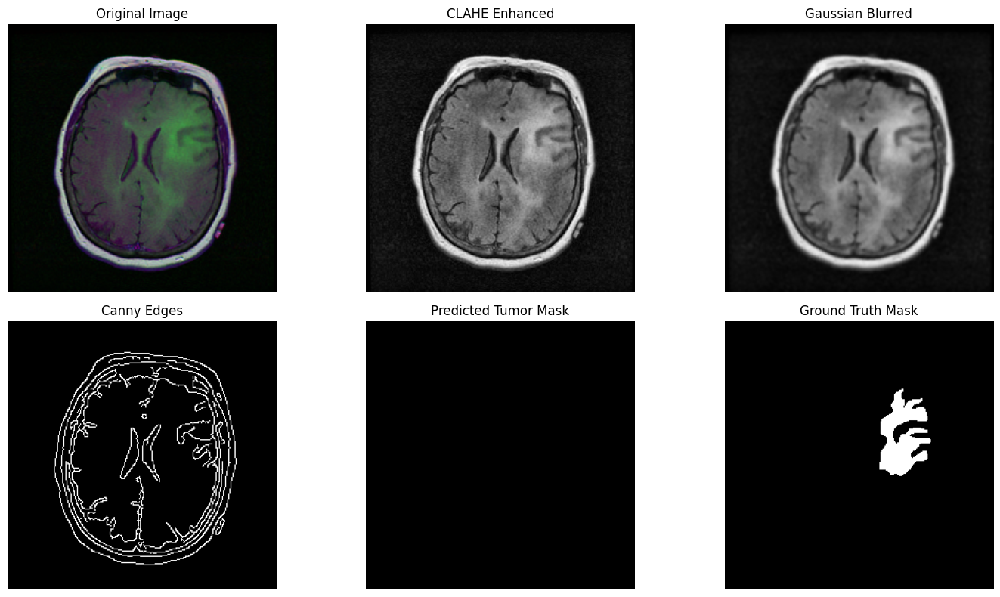

[5] Dice Score: 0.0000


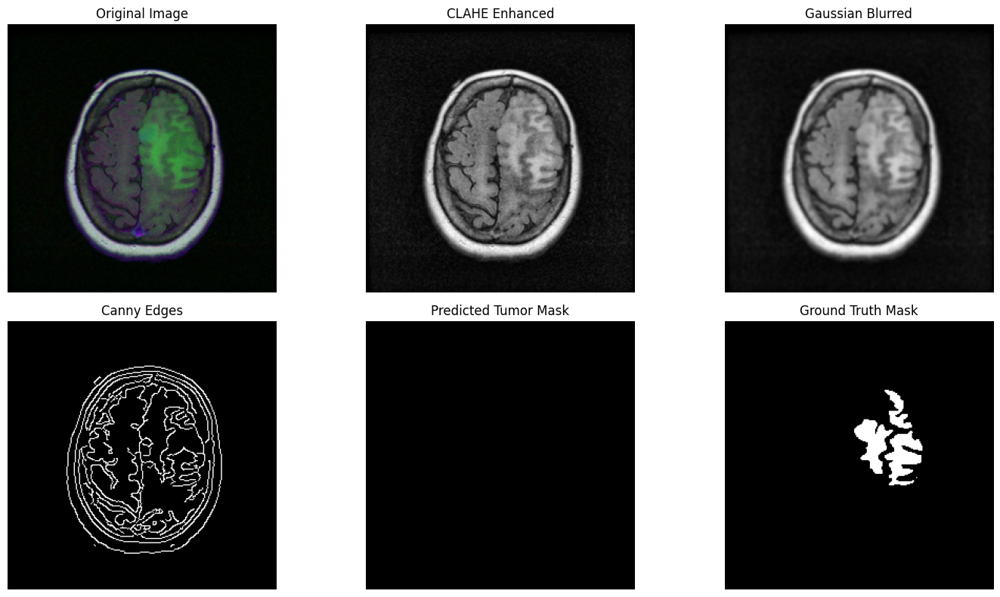

[6] Dice Score: 0.0000


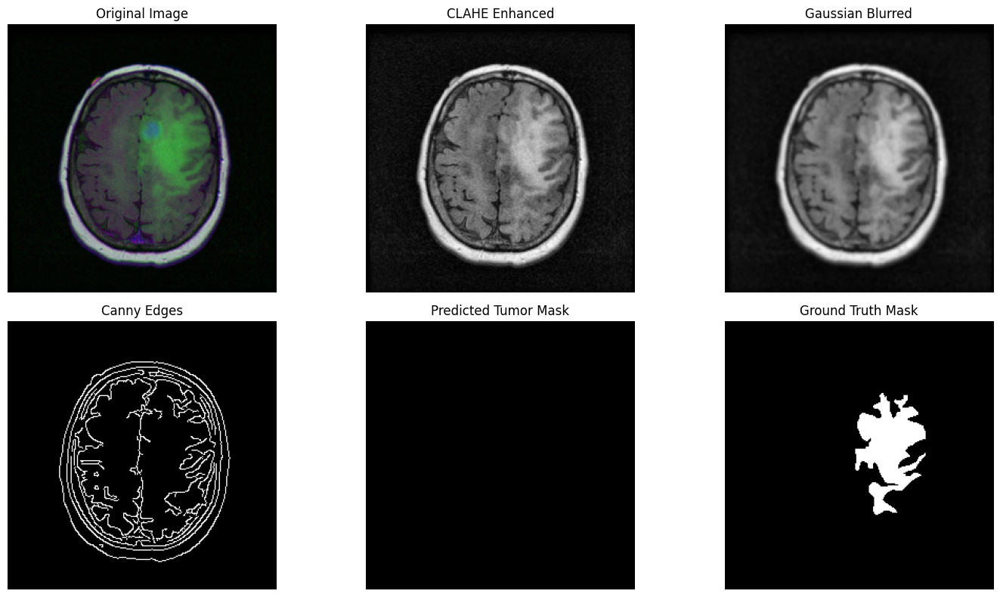

[7] Dice Score: 0.0000


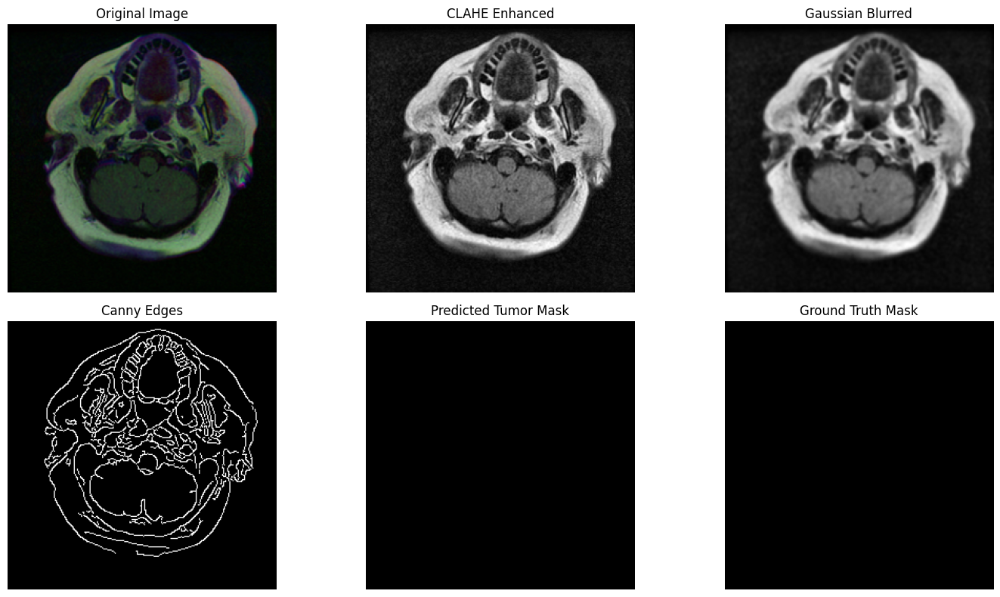

[8] Dice Score: 0.0000


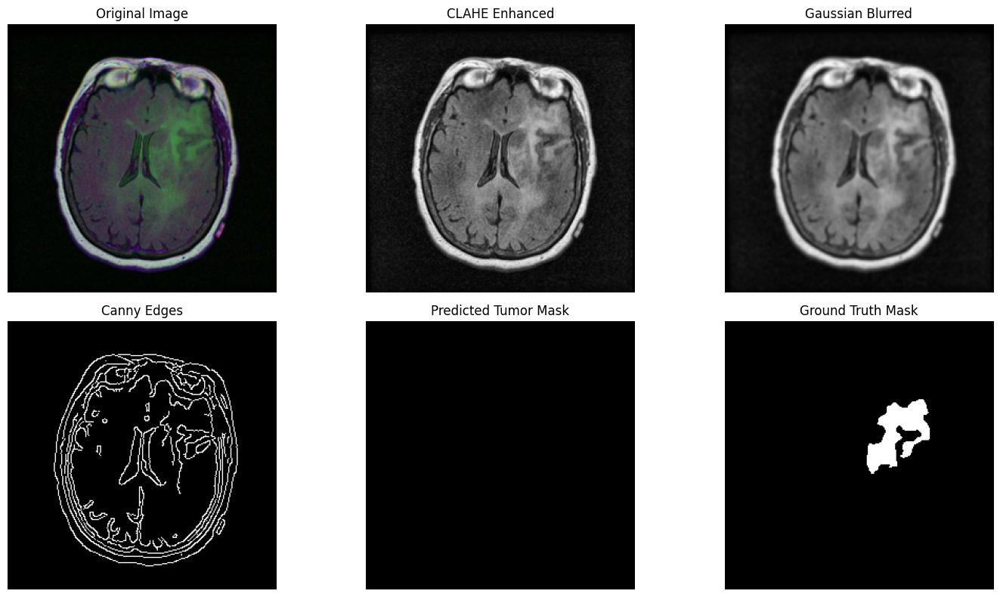

[9] Dice Score: 0.0000


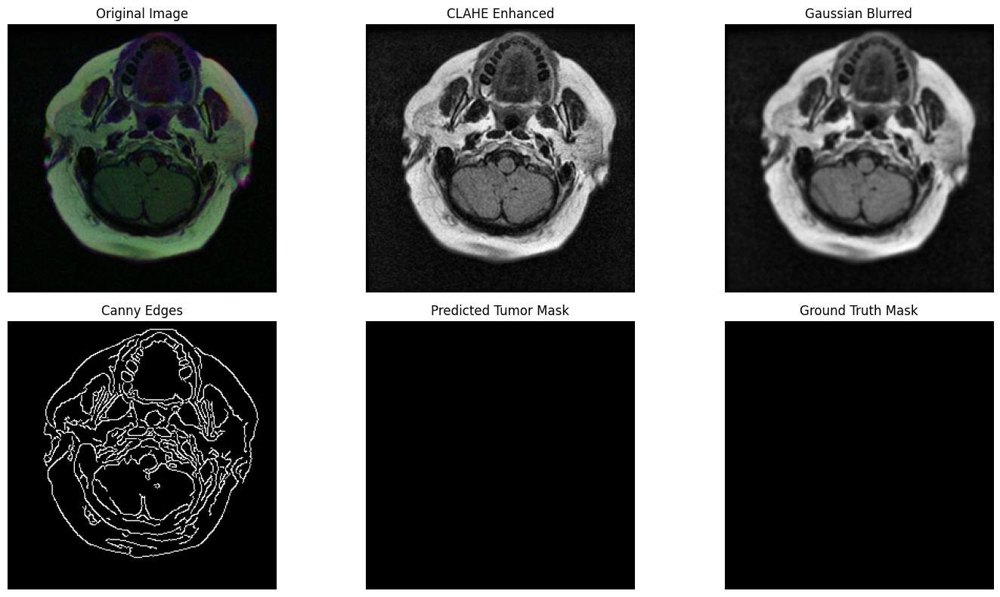

[10] Dice Score: 0.0000


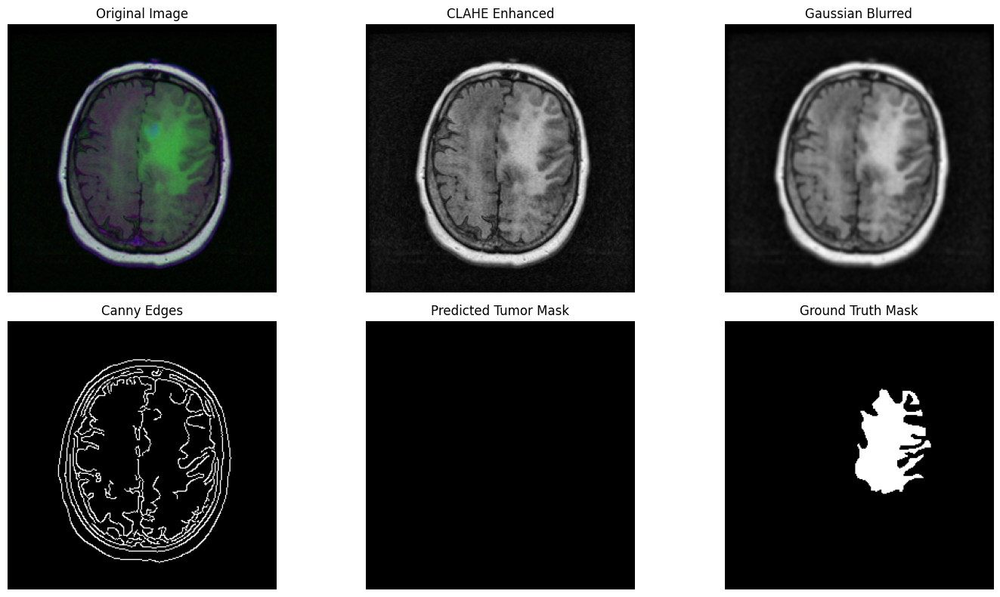


✅ Average Dice Score over 10 samples: 0.0000


In [1]:
# 📦 Imports
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from glob import glob

# 📁 Create dataframe with image/mask pairs
def create_df(data_dir):
    images_paths = []
    masks_paths = glob(f'{data_dir}/*/*_mask*')
    for i in masks_paths:
        images_paths.append(i.replace('_mask', ''))
    df = pd.DataFrame(data={'images_paths': images_paths, 'masks_paths': masks_paths})
    return df

# 🖼️ Image & mask loader
def load_image(path, size=(256, 256)):
    img = cv2.imread(path)
    img = cv2.resize(img, size)
    return img

def load_mask(path, size=(256, 256)):
    mask = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.resize(mask, size)
    _, mask_bin = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)
    return mask_bin

# 🔧 Preprocessing: CLAHE, Blur, Canny Edge Detection
def preprocess_image(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_img = clahe.apply(gray)

    blurred = cv2.GaussianBlur(clahe_img, (5, 5), 0)

    edges = cv2.Canny(blurred, 50, 150)

    # Return preprocessed BGR version (for segmentation), plus grayscale steps for visualization
    preprocessed_bgr = cv2.merge([clahe_img]*3)
    return preprocessed_bgr, clahe_img, blurred, edges

# 🎯 Color segmentation (targeting green-ish areas)
def color_segment(img):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_green = np.array([55, 100, 100])  # Adjust based on dataset
    upper_green = np.array([98, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    result = cv2.bitwise_and(img, img, mask=mask)
    return result, mask

# 📊 Dice Score Calculation
def dice_score(pred_mask, true_mask):
    pred_flat = pred_mask.flatten() // 255
    true_flat = true_mask.flatten() // 255
    intersection = np.sum(pred_flat * true_flat)
    return (2. * intersection) / (np.sum(pred_flat) + np.sum(true_flat) + 1e-7)

# 🧪 Run the full pipeline and show results
def run_pipeline(data_dir, num_samples=5):
    df = create_df(data_dir)
    scores = []

    for i in range(min(num_samples, len(df))):
        img_path = df.iloc[i]['images_paths']
        mask_path = df.iloc[i]['masks_paths']

        img = load_image(img_path)
        gt_mask = load_mask(mask_path)

        # 1️⃣ Preprocessing
        preprocessed_bgr, clahe_img, blurred_img, edge_img = preprocess_image(img)

        # 2️⃣ Color-based segmentation
        pred_result, pred_mask = color_segment(preprocessed_bgr)
        dice = dice_score(pred_mask, gt_mask)
        scores.append(dice)

        print(f"[{i+1}] Dice Score: {dice:.4f}")

        # 3️⃣ Visualization
        plt.figure(figsize=(15, 8))

        plt.subplot(2, 3, 1)
        plt.title("Original Image")
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 3, 2)
        plt.title("CLAHE Enhanced")
        plt.imshow(clahe_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 3)
        plt.title("Gaussian Blurred")
        plt.imshow(blurred_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 4)
        plt.title("Canny Edges")
        plt.imshow(edge_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 5)
        plt.title("Predicted Tumor Mask")
        plt.imshow(pred_mask, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 6)
        plt.title("Ground Truth Mask")
        plt.imshow(gt_mask, cmap='gray')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

    print(f"\n✅ Average Dice Score over {num_samples} samples: {np.mean(scores):.4f}")

# ▶️ Run it!
data_dir = "/kaggle/input/lgg-mri-segmentation/kaggle_3m"
run_pipeline(data_dir, num_samples=10)


[1] Dice Score: 0.0000


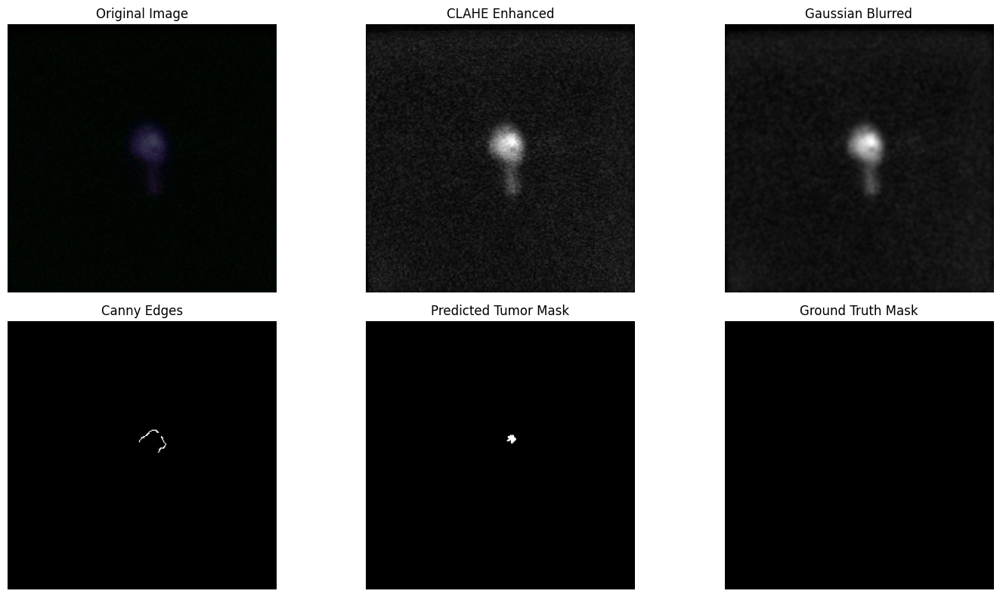

[2] Dice Score: 0.0000


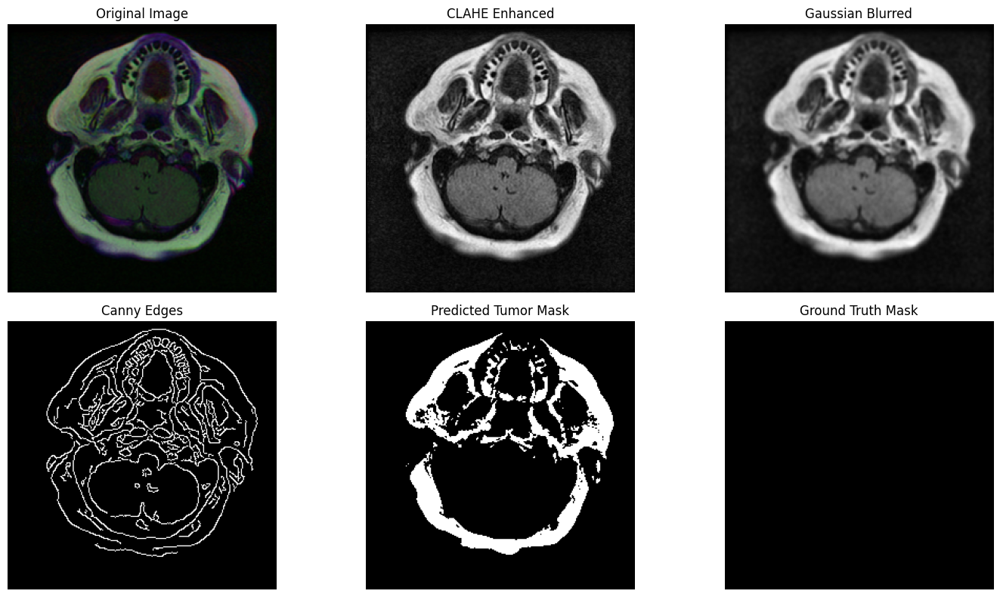

[3] Dice Score: 0.4264


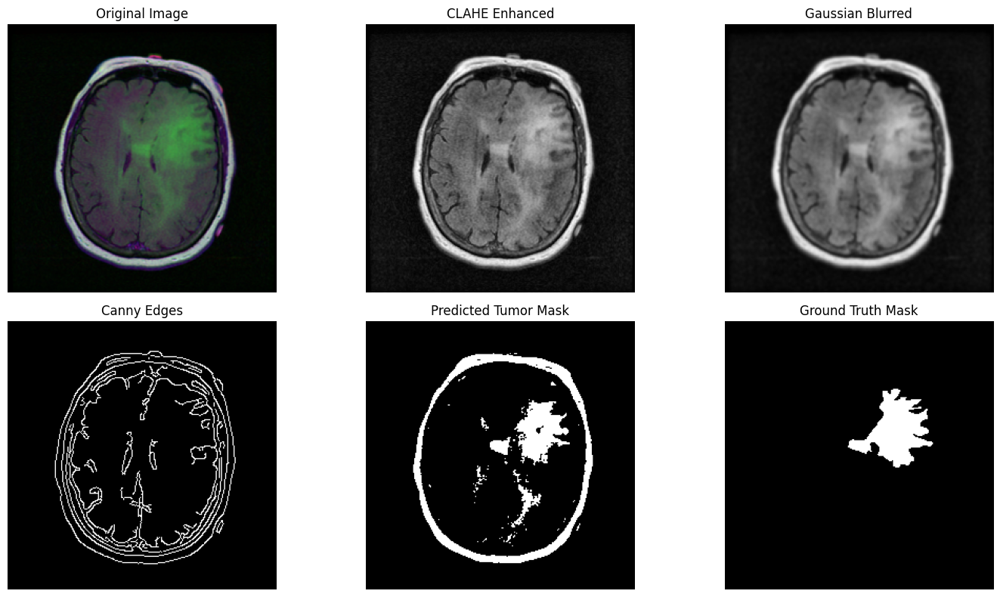

[4] Dice Score: 0.3209


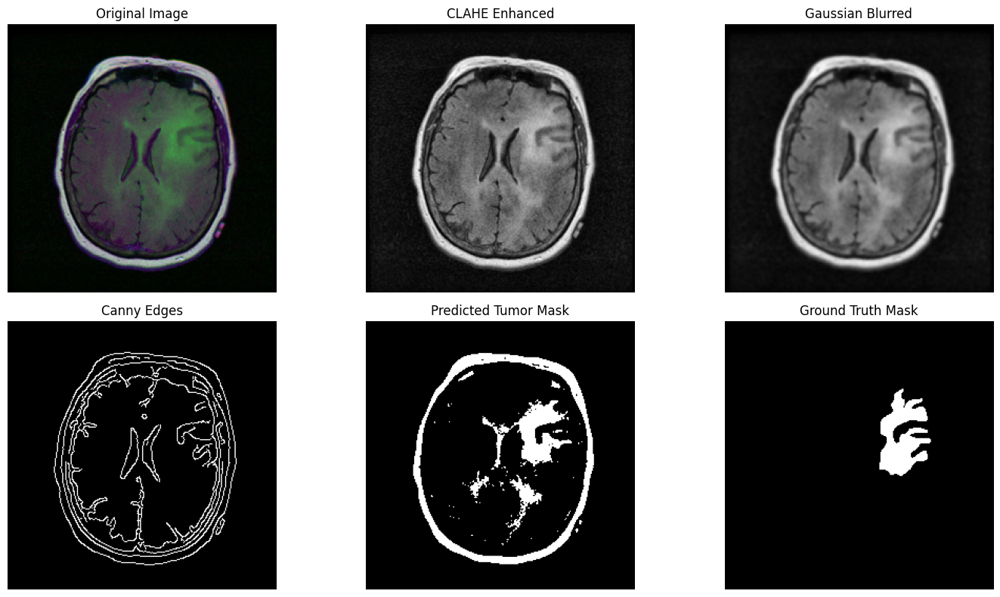

[5] Dice Score: 0.4164


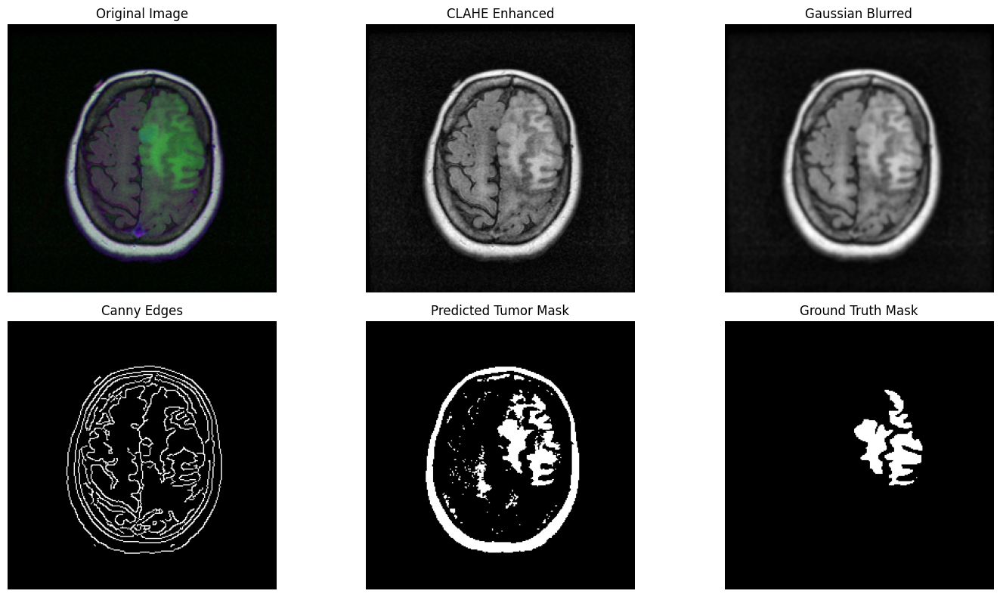

[6] Dice Score: 0.4973


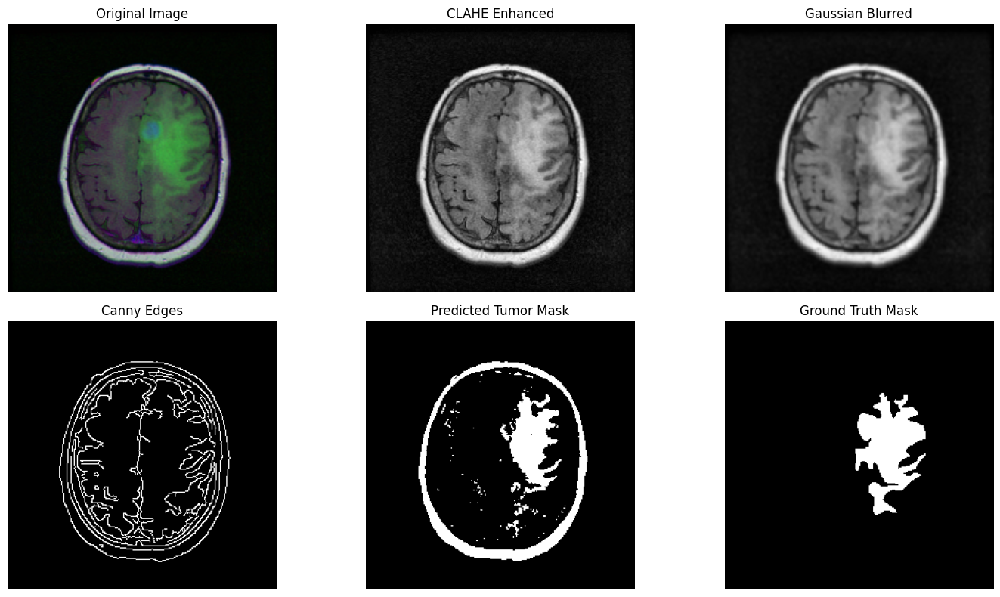

[7] Dice Score: 0.0000


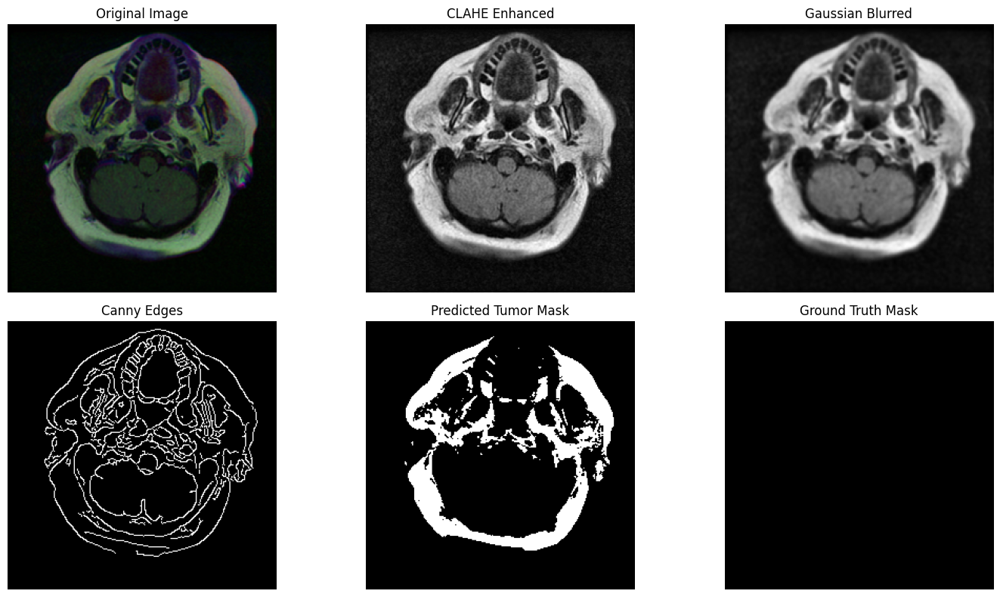

[8] Dice Score: 0.2699


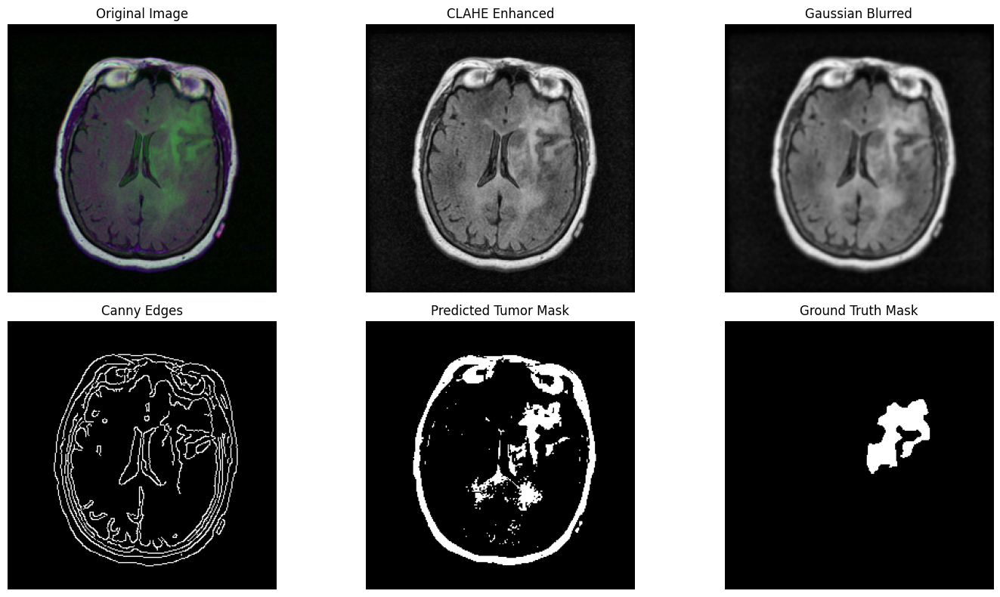

[9] Dice Score: 0.0000


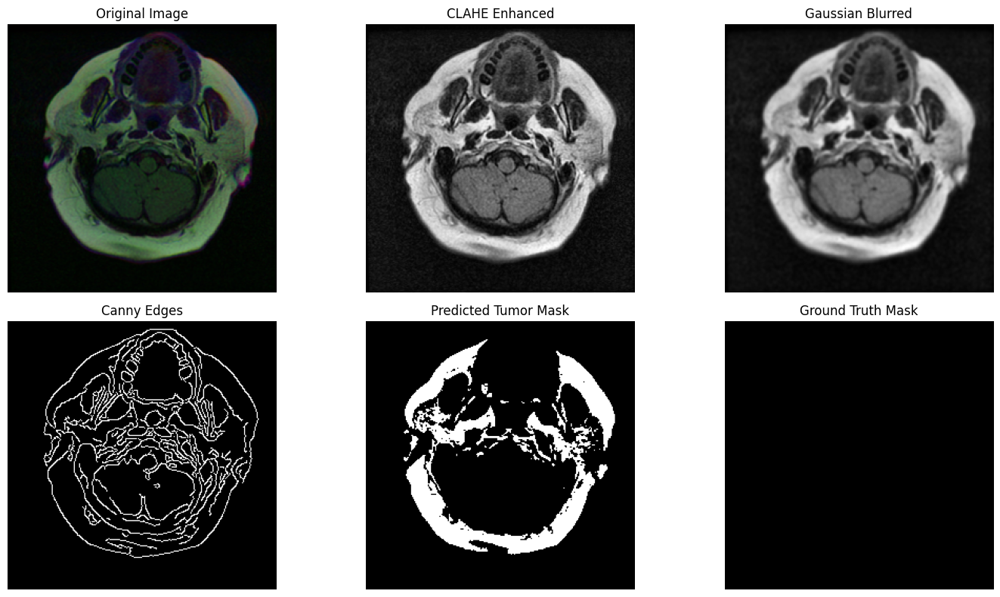

[10] Dice Score: 0.4788


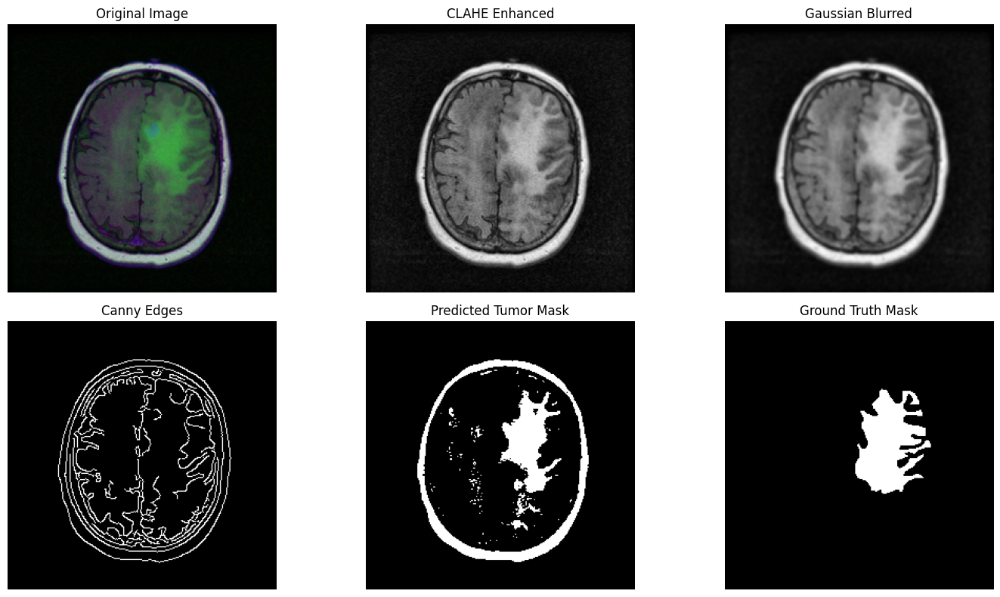


✅ Average Dice Score over 10 samples: 0.2410


In [2]:
# 📦 Imports
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from glob import glob

# 📁 Create dataframe with image/mask pairs
def create_df(data_dir):
    images_paths = []
    masks_paths = glob(f'{data_dir}/*/*_mask*')
    for i in masks_paths:
        images_paths.append(i.replace('_mask', ''))
    df = pd.DataFrame(data={'images_paths': images_paths, 'masks_paths': masks_paths})
    return df

# 🖼️ Image & mask loader
def load_image(path, size=(256, 256)):
    img = cv2.imread(path)
    img = cv2.resize(img, size)
    return img

def load_mask(path, size=(256, 256)):
    mask = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.resize(mask, size)
    _, mask_bin = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)
    return mask_bin

# 🔧 Preprocessing: CLAHE, Blur, Canny Edge Detection
def preprocess_image(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_img = clahe.apply(gray)
    blurred = cv2.GaussianBlur(clahe_img, (5, 5), 0)
    edges = cv2.Canny(blurred, 50, 150)
    preprocessed_bgr = cv2.merge([clahe_img]*3)
    return preprocessed_bgr, clahe_img, blurred, edges

# 🎯 Intensity-based segmentation (thresholding)
def intensity_segment(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # You can fine-tune the threshold value here
    _, mask = cv2.threshold(gray, 130, 255, cv2.THRESH_BINARY)
    result = cv2.bitwise_and(img, img, mask=mask)
    return result, mask

# 📊 Dice Score Calculation
def dice_score(pred_mask, true_mask):
    pred_flat = pred_mask.flatten() // 255
    true_flat = true_mask.flatten() // 255
    intersection = np.sum(pred_flat * true_flat)
    return (2. * intersection) / (np.sum(pred_flat) + np.sum(true_flat) + 1e-7)

# 🧪 Run the full pipeline and show results
def run_pipeline(data_dir, num_samples=5):
    df = create_df(data_dir)
    scores = []

    for i in range(min(num_samples, len(df))):
        img_path = df.iloc[i]['images_paths']
        mask_path = df.iloc[i]['masks_paths']

        img = load_image(img_path)
        gt_mask = load_mask(mask_path)

        # 1️⃣ Preprocessing
        preprocessed_bgr, clahe_img, blurred_img, edge_img = preprocess_image(img)

        # 2️⃣ Intensity-based segmentation
        pred_result, pred_mask = intensity_segment(preprocessed_bgr)
        dice = dice_score(pred_mask, gt_mask)
        scores.append(dice)

        print(f"[{i+1}] Dice Score: {dice:.4f}")

        # 3️⃣ Visualization
        plt.figure(figsize=(15, 8))

        plt.subplot(2, 3, 1)
        plt.title("Original Image")
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 3, 2)
        plt.title("CLAHE Enhanced")
        plt.imshow(clahe_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 3)
        plt.title("Gaussian Blurred")
        plt.imshow(blurred_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 4)
        plt.title("Canny Edges")
        plt.imshow(edge_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 5)
        plt.title("Predicted Tumor Mask")
        plt.imshow(pred_mask, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 3, 6)
        plt.title("Ground Truth Mask")
        plt.imshow(gt_mask, cmap='gray')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

    print(f"\n✅ Average Dice Score over {num_samples} samples: {np.mean(scores):.4f}")

# ▶️ Run it!
data_dir = "/kaggle/input/lgg-mri-segmentation/kaggle_3m"
run_pipeline(data_dir, num_samples=10)


[1] Dice Score: 0.0000


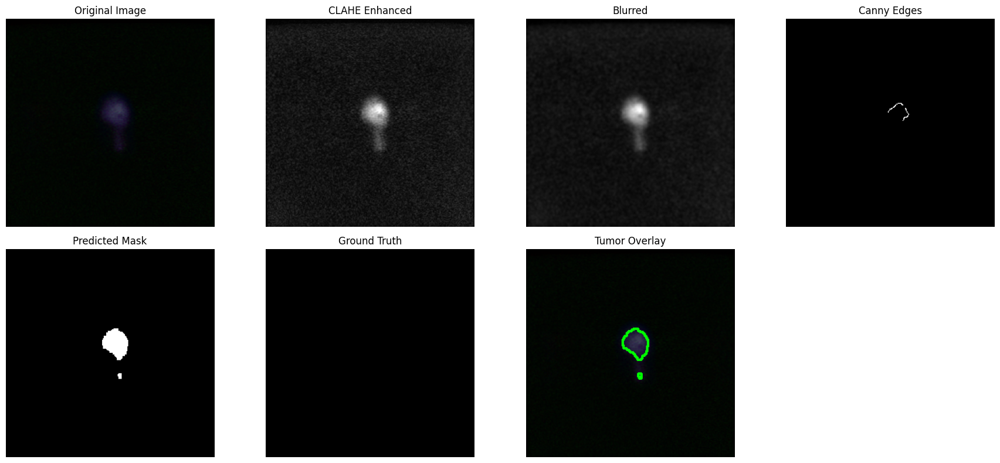

[2] Dice Score: 0.0000


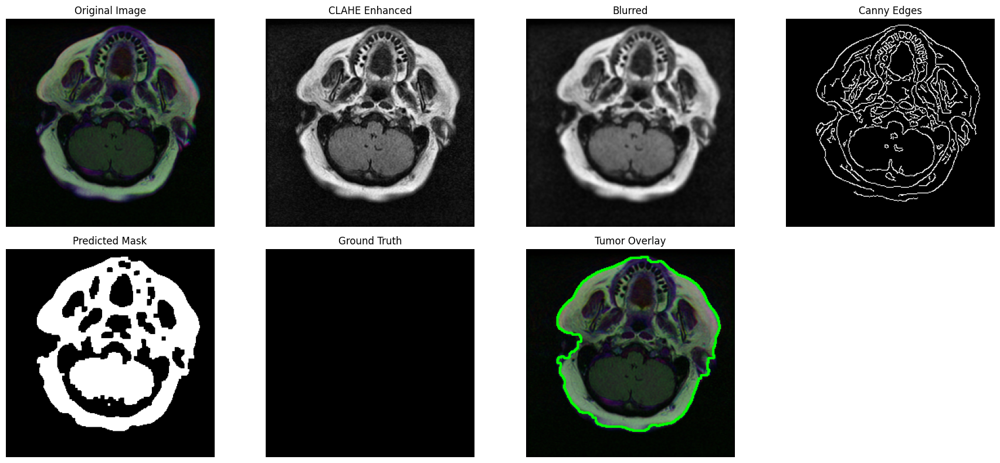

[3] Dice Score: 0.1896


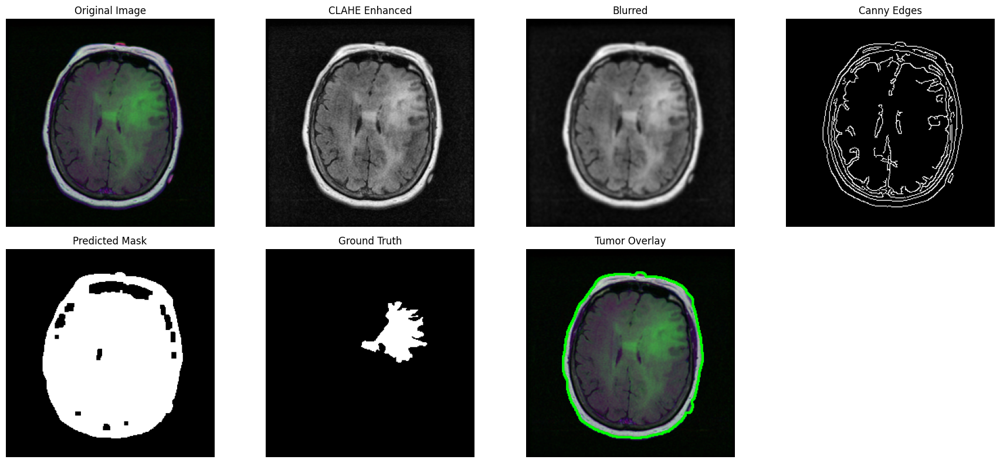

[4] Dice Score: 0.1534


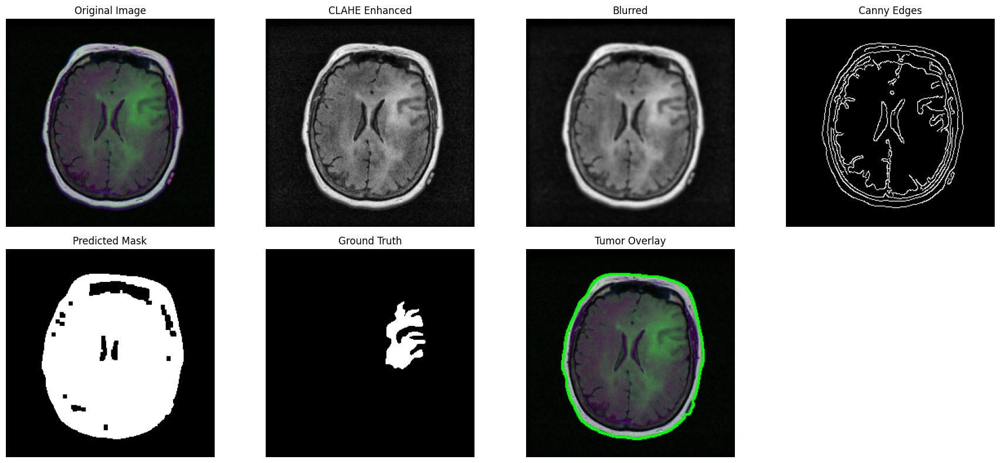

[5] Dice Score: 0.2107


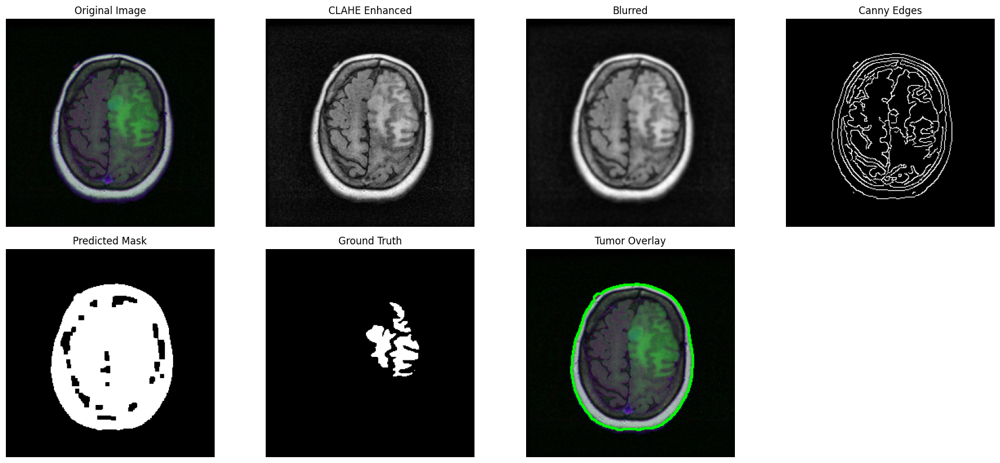

[6] Dice Score: 0.2830


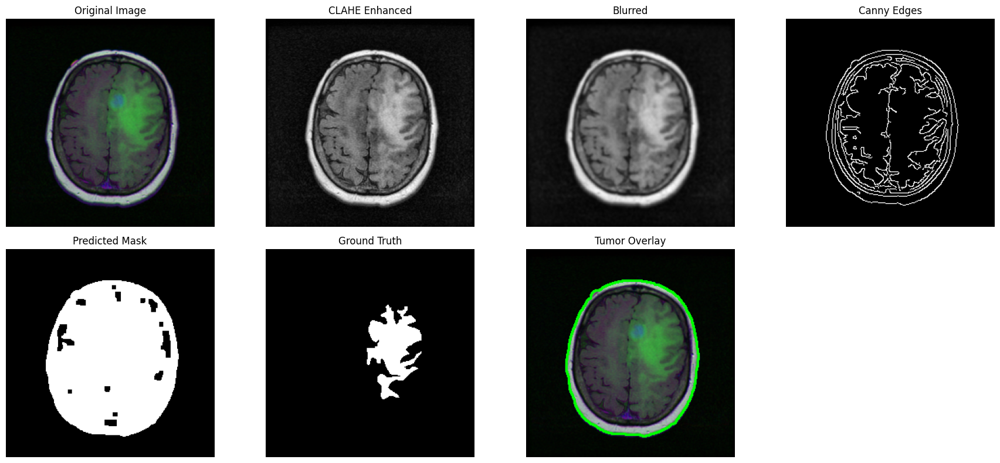

[7] Dice Score: 0.0000


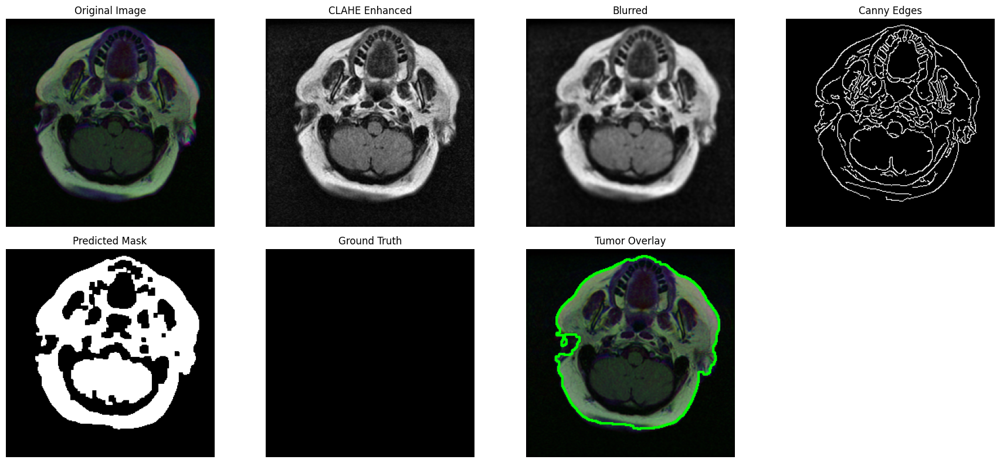

[8] Dice Score: 0.1427


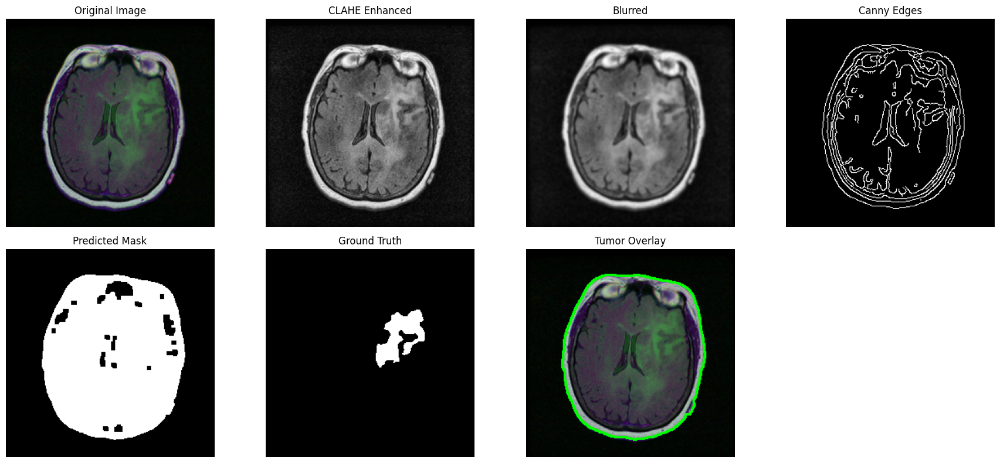

[9] Dice Score: 0.0000


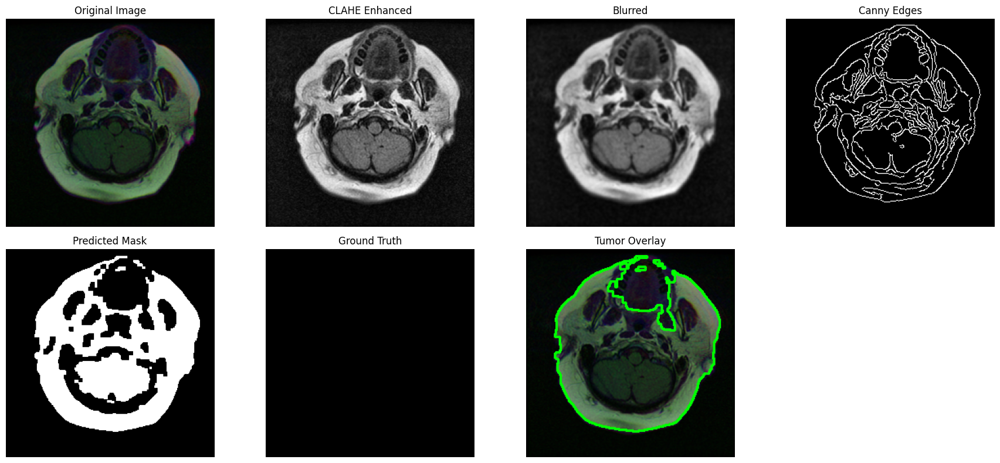

[10] Dice Score: 0.2889


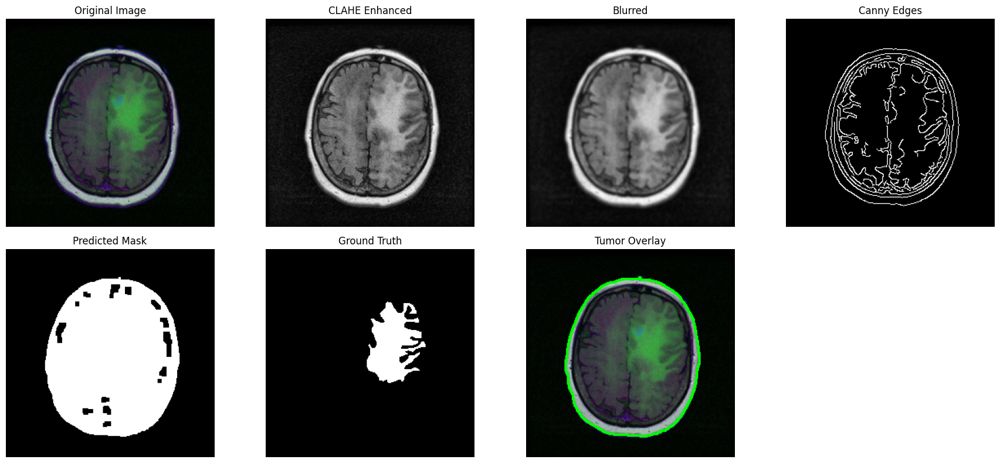


✅ Average Dice Score over 10 samples: 0.1268


In [3]:
# 📦 Imports
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from glob import glob

# 📁 Create dataframe with image/mask paths
def create_df(data_dir):
    images_paths = []
    masks_paths = glob(f'{data_dir}/*/*_mask*')
    for i in masks_paths:
        images_paths.append(i.replace('_mask', ''))
    df = pd.DataFrame({'images_paths': images_paths, 'masks_paths': masks_paths})
    return df

# 🖼️ Image & mask loading
def load_image(path, size=(256, 256)):
    img = cv2.imread(path)
    img = cv2.resize(img, size)
    return img

def load_mask(path, size=(256, 256)):
    mask = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.resize(mask, size)
    _, mask_bin = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)
    return mask_bin

# 🔧 Preprocessing steps
def preprocess_image(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8)).apply(gray)
    blurred = cv2.GaussianBlur(clahe, (5, 5), 0)
    edges = cv2.Canny(blurred, 50, 150)
    return cv2.merge([clahe]*3), clahe, blurred, edges

# 🎯 Intensity-based segmentation + morphology
def intensity_segment(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    _, mask = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    kernel = np.ones((3, 3), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)

    result = cv2.bitwise_and(img, img, mask=mask)
    return result, mask

# 🧩 Dice score
def dice_score(pred_mask, true_mask):
    pred_flat = pred_mask.flatten() // 255
    true_flat = true_mask.flatten() // 255
    intersection = np.sum(pred_flat * true_flat)
    return (2. * intersection) / (np.sum(pred_flat) + np.sum(true_flat) + 1e-7)

# 🧾 Contour overlay
def overlay_contours(img, mask):
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    overlay = img.copy()
    cv2.drawContours(overlay, contours, -1, (0, 255, 0), 2)
    return overlay

# 🧪 Full pipeline
def run_pipeline(data_dir, num_samples=5):
    df = create_df(data_dir)
    scores = []

    for i in range(min(num_samples, len(df))):
        img_path = df.iloc[i]['images_paths']
        mask_path = df.iloc[i]['masks_paths']

        img = load_image(img_path)
        gt_mask = load_mask(mask_path)

        # Preprocessing
        preprocessed_bgr, clahe_img, blurred_img, edge_img = preprocess_image(img)

        # Segmentation
        pred_result, pred_mask = intensity_segment(preprocessed_bgr)
        dice = dice_score(pred_mask, gt_mask)
        scores.append(dice)

        overlayed_img = overlay_contours(img, pred_mask)

        print(f"[{i+1}] Dice Score: {dice:.4f}")

        # Plotting
        plt.figure(figsize=(18, 8))

        plt.subplot(2, 4, 1)
        plt.title("Original Image")
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 4, 2)
        plt.title("CLAHE Enhanced")
        plt.imshow(clahe_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 4, 3)
        plt.title("Blurred")
        plt.imshow(blurred_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 4, 4)
        plt.title("Canny Edges")
        plt.imshow(edge_img, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 4, 5)
        plt.title("Predicted Mask")
        plt.imshow(pred_mask, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 4, 6)
        plt.title("Ground Truth")
        plt.imshow(gt_mask, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 4, 7)
        plt.title("Tumor Overlay")
        plt.imshow(cv2.cvtColor(overlayed_img, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.tight_layout()
        plt.show()

    print(f"\n✅ Average Dice Score over {num_samples} samples: {np.mean(scores):.4f}")

# ▶️ Run it!
data_dir = "/kaggle/input/lgg-mri-segmentation/kaggle_3m"
run_pipeline(data_dir, num_samples=10)
